# Shower start dE/dx tutorial

This notebook goes over how to grab the shower start dE/dx information to validate the lartpc_mlreco_3d and help develop selections to seperate electron and gamma showers. 

This notebook has 3 functions that calculate shower start dE/dx (truth particles, reco particles, and matched particles). They are designed to add additional changes for people's personal needs. 


In [1]:
# Basic boilerplate imports
import numpy as np
import pandas as pd
import yaml, os, sys, re
from scipy.spatial.distance import cdist

# Visualization Tools
import plotly
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import matplotlib.pyplot as plt
import seaborn as sns
from pprint import pprint
from IPython.display import Image

### 1 - Overview of shower start dE/dx
Shower start dE/dx is looking at the energy deposited at the beginning of the shower where we expect to see electrons have ~2 MeV/cm for dE/dx and photons that pair produce have ~4 MeV/cm in liquid argon detectors. There are a couple reasons why we expect to see these values
    
1.) At the start of these shower we expect to see track like trail since the electrons/positrons haven't had to a chance to create secondary particles.

2.) We expect ~4 MeV/cm for photons decaying in pair production because it will have an electron and positron compared to an electron shower which is only one.
    
We can use this information to help validate that lartpc_mlreco_3d is classifying particles correctly, start point is correctly identfied, deghosting is working, etc. Though this can be as additional selection cuts to improve physics analyses. 

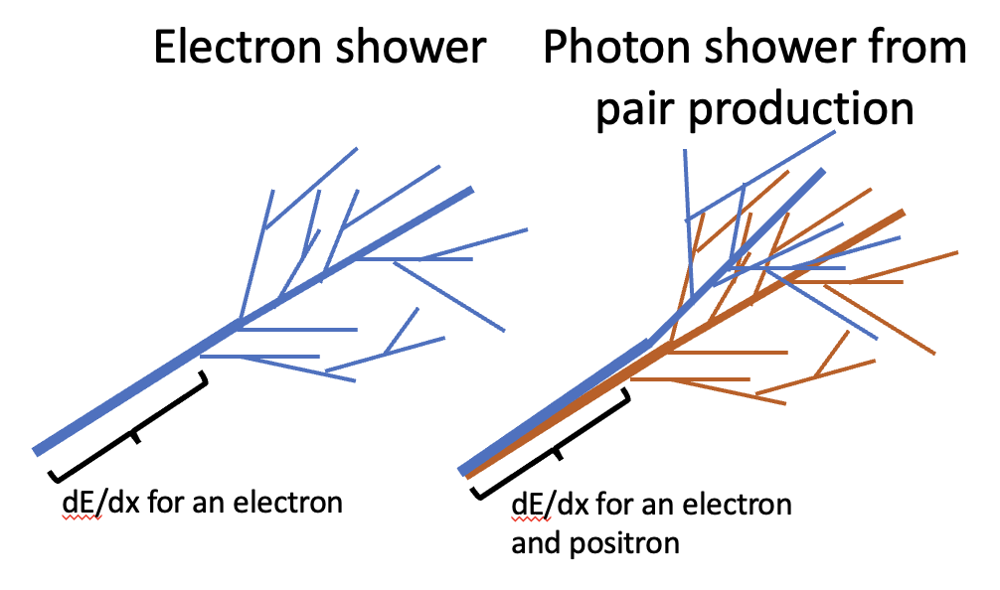

In [2]:
Image(filename="shower_dedx.png")

### 2 - Setting up lartpc_mlreco3d

In [3]:
import os, sys

# SOFTWARE_DIR = '/sdf/data/neutrino/software/spine' # Change this path to your software install
SOFTWARE_DIR = '/sdf/group/neutrino/drielsma/dev/spine' # Change this path to your software install
DATA_DIR = '/sdf/data/neutrino/public_html/spine_workshop/' # Change this path if you are not on SDF (see main README)

# Set software directory
sys.path.insert(0, SOFTWARE_DIR)

In [4]:
# Load anatools config file
# Replace the source file with the correct path
# DATA_PATH = DATA_DIR + 'reco/sbnd_medium_spine.h5'
DATA_PATH = DATA_DIR + 'reco/icarus_medium_spine.h5'
cfg = '../../template.cfg' 
cfg = yaml.safe_load(open(cfg, 'r').read().replace('DATA_PATH', DATA_PATH))

In [5]:
# Initialize Anatools manager
from spine.driver import Driver

driver = Driver(cfg)

Welcome to JupyROOT 6.22/08

 ██████████   ██████████    ███   ███       ██   ███████████
███        █  ██       ███   █    █████     ██   ██         
  ████████    ██       ███  ███   ██  ████  ██   ██████████ 
█        ███  ██████████     █    ██     █████   ██         
 ██████████   ██            ███   ██       ███   ███████████

Release version: 0.1.0

$CUDA_VISIBLE_DEVICES=

Configuration processed at: Linux sdfampere039 4.18.0-372.32.1.el8_6.x86_64 #1 SMP Fri Oct 7 12:35:10 EDT 2022 x86_64 x86_64 x86_64 GNU/Linux

base: {seed: 1721879513}
io:
  reader: {name: hdf5, file_keys: /sdf/data/neutrino/public_html/spine_workshop/reco/icarus_medium_spine.h5}
build: {mode: both, units: cm, fragments: false, particles: true, interactions: true}

Will load 1 file(s):
  - /sdf/data/neutrino/public_html/spine_workshop/reco/icarus_medium_spine.h5

Total number of entries in the file(s): 256

Total number of entries selected: 256



In [6]:
# Get entry number #ENTRY_NUM from HDF5 (when reading from HDF5)
ENTRY_NUM = 0
data = driver.process(entry=ENTRY_NUM)

## 3- What does a shower in SPINE look like 

In [7]:
from spine.vis import layout3d
from spine.vis.out import Drawer

In [8]:
vis_particles          = data['reco_particles']
vis_truth_particles    = data['truth_particles']
print(vis_particles[2])
#print(particles[8]) #If using SDF 
print(vis_truth_particles[2])

RecoParticle(ID: 2   | PID: Electron | Primary: 1  | Size: 1417  | Match: 2  )
TruthParticle(ID: 2   | PID: Photon   | Primary: 1  | Size: 1437  | Match: 2  )


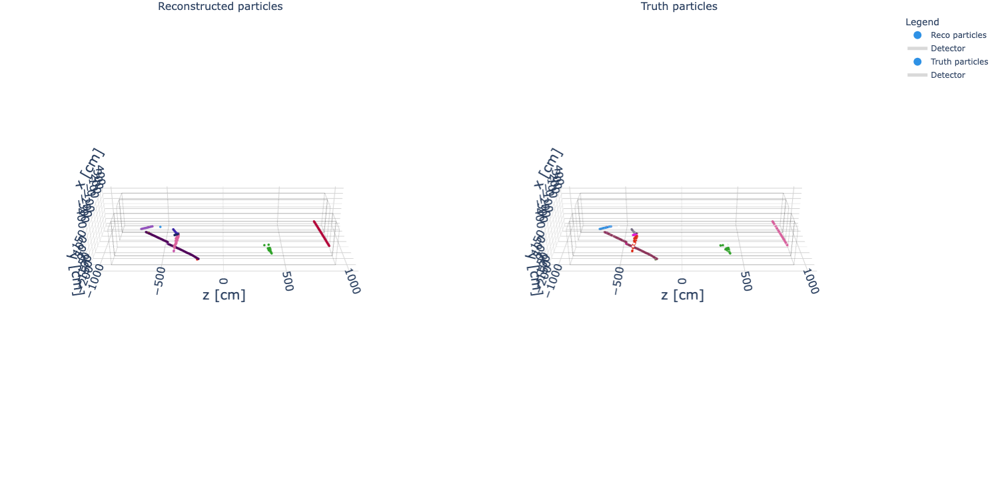

In [9]:
drawer = Drawer(data, detector='icarus')

fig = drawer.get('particles', attr='id')

fig.show()

Now let's a ball around the start of the two showers (reco and truth)...

In [10]:
def spheres(size, clr, startpoints, scene=None): 
    
    # Set up 100 points. First, do angles
    theta = np.linspace(0,2*np.pi,100)
    phi = np.linspace(0,np.pi,100)
    
    # Set up coordinates for points on the sphere
    x0 = startpoints[0] + size * np.outer(np.cos(theta),np.sin(phi))
    y0 = startpoints[1] + size * np.outer(np.sin(theta),np.sin(phi))
    z0 = startpoints[2] + size * np.outer(np.ones(100),np.cos(phi))
    
    # Set up trace
    sphere= go.Surface(x=x0, y=y0, z=z0, colorscale=[[0,clr], [1,clr]],opacity = .2,  scene=scene)
    sphere.update(showscale=False)

    return sphere

In [11]:
vis_particles[2].start_point

array([-222.54001, -152.91   ,  393.99908], dtype=float32)

In [12]:
vis_truth_particles[2].start_point

array([-222.54   , -152.91   ,  393.99896], dtype=float32)

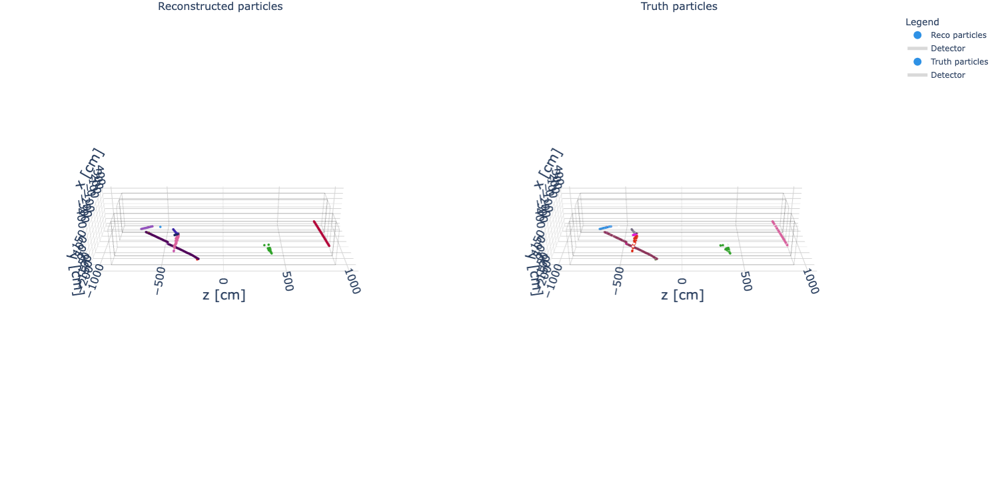

In [13]:
# Template cell for side-by-side event displays
reco_sphere = spheres(size=3, clr = 'red', startpoints = vis_particles[2].start_point, scene='scene1')
true_sphere = spheres(size=3, clr = 'red', startpoints = vis_truth_particles[2].start_point, scene='scene2')

go.Figure([*fig['data'], reco_sphere, true_sphere], layout=fig['layout'])

### 3. Grabbing true shower dE/dx
Inputs to shower start dE/dx function
 * **`true_particles`** : list of true particles
 
 * **`r`** :  radius of circle that we calculate the dE/dx from
 
 * **`min_segment_size`** : minimum size of the shower start that you want to use
 
 Outputs to shower start dE/dx function
 * **`true_dedx`** : list of true dE/dx of all selected showers
 
 * **`true_electron`** :  list of true electron's dE/dx  
 
 * **`true_photon`** : list of true photons's dE/dx
 
 * **`true_dE`** :  list of true energy of the shower start 
 
 * **`true_dx`** : list of true length shower start
 

In [14]:
from sklearn.decomposition import PCA
from scipy.spatial.distance import cdist
pca = PCA(n_components=2)

In [15]:
def compute_true_shower_dqdx(true_particles, r=3, min_segment_size=.9):
    '''
    Inputs:
        - true_particles: List of true particles
        - r: radius of collection area [cm]
        - min_segment_size: minimum segment size of shower start [cm]
    Returns:
        - true_dedx: dE/dx of true shower start [MeV/cm]
        - true_electron:  dE/dx of true electron shower start [MeV/cm]
        - true_photon: dE/dx of true photon shower start [MeV/cm]
    '''
    '''Variables'''
    true_dedx = []
    true_electron = []
    true_photon = []
    true_dE = []
    true_dx = []
    
    for i in range(len(true_particles)): 
        '''Makes sure the particles are what we want'''
        if(true_particles[i].pid > 1): 
            continue
        if(true_particles[i].shape > 1):
            continue
        if true_particles[i].is_primary == False:
            continue
        
        '''Grabs dx information '''
        true_startpoint = true_particles[i].start_point
        true_dist = cdist(true_particles[i].points, true_startpoint.reshape(1,-1))
        true_mask = true_dist.squeeze() < r       
        true_selected_points = true_particles[i].points[true_mask]
        if true_selected_points.shape[0] < 2:
            continue
        # true_proj = pca.fit_transform(true_selected_points)
        # dx = (true_proj[:,0].max() - true_proj[:,0].min())
        dx = np.max(true_dist[true_mask])
        if dx < min_segment_size:
            continue
        
        '''Grabs dE information'''
        dq = np.sum(true_particles[i].depositions[true_mask])
        
        true_dedx.append(dq/dx)
        true_dE.append(dq)
        true_dx.append(dx)
        if true_particles[i].pid == 0:   
            true_photon.append(dq/dx)
        if true_particles[i].pid == 1:
            true_electron.append(dq/dx)
    
    return true_dedx, true_electron, true_photon, true_dE, true_dx


In [16]:
events = 100
collect_true_dedx = []
collect_true_electron = []
collect_true_photon = []
collect_true_dE = []
collect_true_dx = []
#sys.stdout = open(os.devnull, 'w')
for event in range(events):
    data = driver.process(entry=event)
    # print(event)
    truth_particles = data['truth_particles']
    dedx, electron_dedx, photon_dedx, energy, dist = compute_true_shower_dqdx(truth_particles)
    collect_true_dedx.extend(dedx)
    collect_true_electron.extend(electron_dedx)
    collect_true_photon.extend(photon_dedx)
    collect_true_dE.extend(energy)
    collect_true_dx.extend(dist)
#sys.stdout = sys.__stdout__

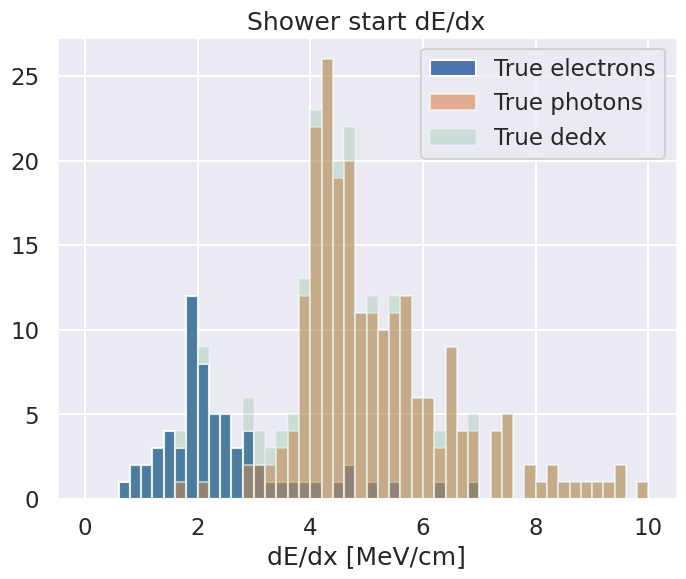

In [17]:
sns.set(rc={
    'figure.figsize':(8, 6),
})
sns.set_context('talk')
#plt.hist(m_true_electron["electrons"], range=[0, 10],bins=50,alpha =1, label = "True Electrons Init")
plt.hist(collect_true_electron, range=[0, 10], alpha = 1,bins=50,label = "True electrons")
plt.hist(collect_true_photon, range=[0, 10],alpha = .6,bins=50, label = "True photons")
plt.hist(collect_true_dedx, range=[0, 10],alpha = .2,bins=50, label = "True dedx")



plt.legend(loc = "upper right")
plt.xlabel("Voxels")
plt.xlabel("dE/dx [MeV/cm]")
#plt.ylabel("Showers")
plt.title("Shower start dE/dx")
plt.show()
#plt.savefig('dedx_4000_events.png')

### 4 - Calculating reco shower start dE/dx
This will require a change to how we find dE to the function that we used for the true particles.

The ADC to MeV conversion is done by the calibration post-processor (see the shower energy notebook).

In [18]:
def compute_reco_shower_dqdx(particles, interactions=None, r=3, min_segment_size=.9):

    '''List of arrays and declaring variables'''
    
    # True output
    reco_dedx = []
    reco_electron = []
    reco_photon = []
    reco_dE = []
    reco_dx = []
    
    meta = data['meta']
    for i in range(len(particles)): #Loops over all particles in the matched particle list
        '''Makes sure the particles are what we want'''
        #particles[i]
        if(particles[i].pid > 1): #Selects either photon or electron particles
            continue
        if(particles[i].shape > 1):#Selects fragment showers
            continue
        if particles[i].is_primary == False:
            continue
        if particles[i].calo_ke < 50:
            continue

        '''Grabs true particle information if the true points are within the assigned radius '''
        startpoint = particles[i].start_point
        # vertex = interactions[particles[i].interaction_id].vertex
        # startpoint = particles[i].points[np.argmin(cdist([vertex], particles[i].points))]
        # print(startpoint)
        
        dist = cdist(particles[i].points, startpoint.reshape(1,-1))
        mask = dist.squeeze() < r #Are the points' distance from start point within selected radius
        selected_points = particles[i].points[mask]#Grabs true points that are within the radius
        if selected_points.shape[0] < 2:# Makes sure there are enough points
            continue
        # proj = pca.fit_transform(selected_points)
        # dx = (proj[:,0].max() - proj[:,0].min())
        dx = np.max(dist[mask])
        if dx < min_segment_size:
            continue
        
        # dq = calculate_shower_energy(particles[i],meta,mask = mask)
        dq = np.sum(particles[i].depositions[mask])
        

        reco_dedx.append(dq/dx)
        reco_dE.append(dq)
        reco_dx.append(dx)
        if particles[i].pid == 0:   
            reco_photon.append(dq/dx)
        if particles[i].pid == 1:
            reco_electron.append(dq/dx)
           
    
    return reco_dedx, reco_electron, reco_photon, reco_dE, reco_dx


In [19]:
events = 100
collect_reco_dedx = []
collect_reco_electron = []
collect_reco_photon = []
collect_reco_dE = []
collect_reco_dx = []
for event in range(events):
    data = driver.process(entry=event)
    # print(event)
    particles = data['reco_particles']
    interactions = data['reco_interactions']
    dedx, electron_dedx, photon_dedx, energy, dist = compute_reco_shower_dqdx(particles, interactions)
    collect_reco_dedx.extend(dedx)
    collect_reco_electron.extend(electron_dedx)
    collect_reco_photon.extend(photon_dedx)
    collect_reco_dE.extend(energy)
    collect_reco_dx.extend(dist)

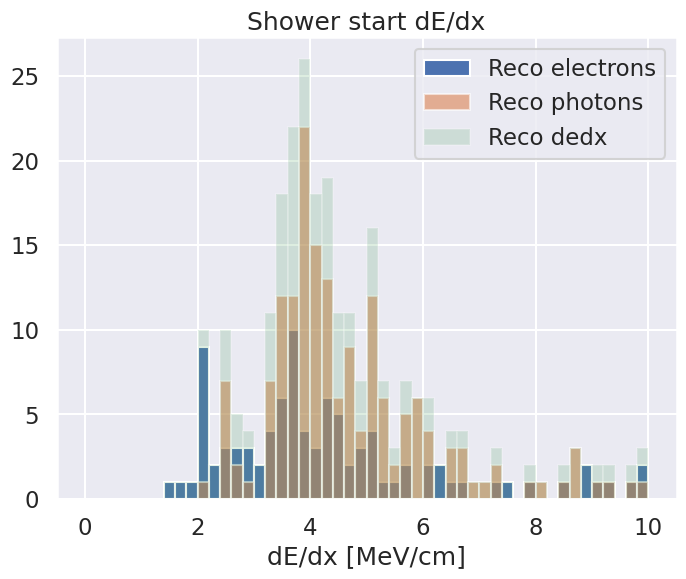

In [20]:
sns.set(rc={
    'figure.figsize':(8, 6),
})
sns.set_context('talk')
#plt.hist(m_true_electron["electrons"], range=[0, 10],bins=50,alpha =1, label = "True Electrons Init")
plt.hist(collect_reco_electron, range=[0, 10], alpha = 1,bins=50,label = "Reco electrons")
plt.hist(collect_reco_photon, range=[0, 10],alpha = .6,bins=50, label = "Reco photons")
plt.hist(collect_reco_dedx, range=[0, 10],alpha = .2,bins=50, label = "Reco dedx")



plt.legend(loc = "upper right")
plt.xlabel("Voxels")
plt.xlabel("dE/dx [MeV/cm]")
#plt.ylabel("Showers")
plt.title("Shower start dE/dx")
plt.show()
#plt.savefig('dedx_4000_events.png')

### 5 - Investigating failure points
Obviously the reco does not look like what we saw for the true dE/dx. This could be due to many things, but to help isolate what the problem we can look at the dx and dE seperatly.

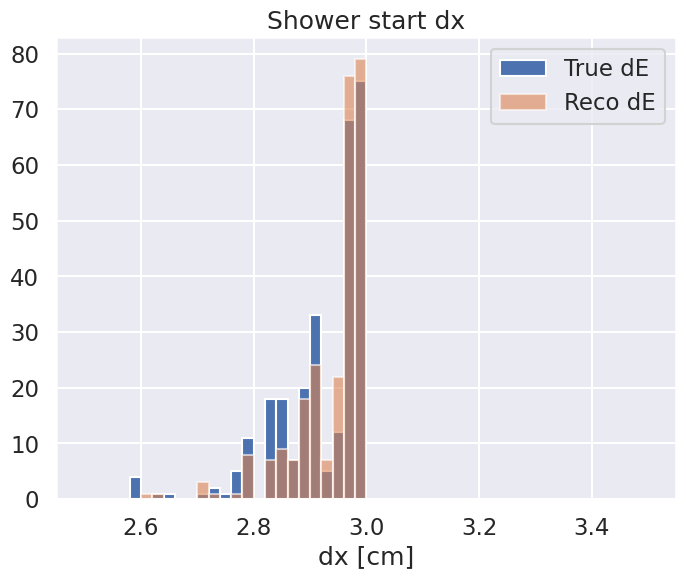

In [21]:
sns.set(rc={
    'figure.figsize':(8, 6),
})
sns.set_context('talk')
#plt.hist(m_true_electron["electrons"], range=[0, 10],bins=50,alpha =1, label = "True Electrons Init")
plt.hist(collect_true_dx, range=[2.5, 3.5], alpha = 1,bins=50,label = "True dE")
plt.hist(collect_reco_dx, range=[2.5, 3.5], alpha = .6,bins=50,label = "Reco dE")

plt.legend(loc = "upper right")
plt.xlabel("Voxels")
plt.xlabel("dx [cm]")
#plt.ylabel("Showers")
plt.title("Shower start dx")
plt.show()
#plt.savefig('dedx_4000_events.png')

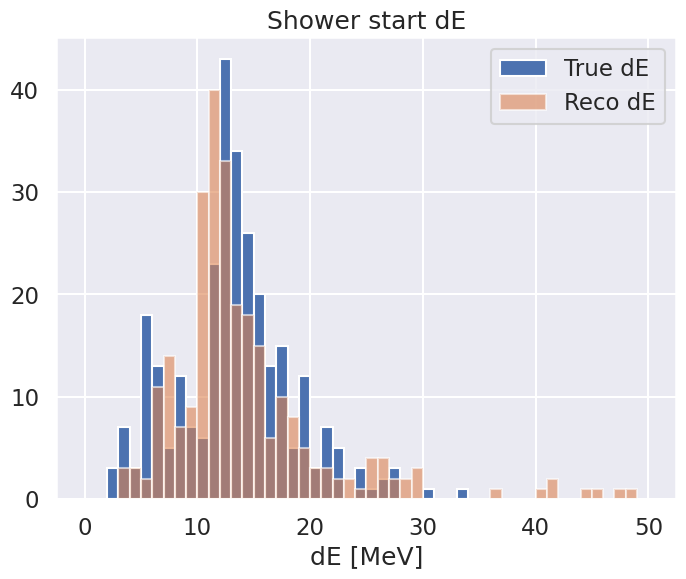

In [22]:
sns.set(rc={
    'figure.figsize':(8, 6),
})
sns.set_context('talk')
#plt.hist(m_true_electron["electrons"], range=[0, 10],bins=50,alpha =1, label = "True Electrons Init")
plt.hist(collect_true_dE, range=[0, 50], alpha = 1,bins=50,label = "True dE")
plt.hist(collect_reco_dE, range=[0, 50], alpha = .6,bins=50,label = "Reco dE")

plt.legend(loc = "upper right")
plt.xlabel("Voxels")
plt.xlabel("dE [MeV]")
#plt.ylabel("Showers")
plt.title("Shower start dE")
plt.show()
#plt.savefig('dedx_4000_events.png')

In [ ]:
# Template cell for side-by-side event displays
fig = drawer.get('particles', 'id')

reco_sphere = spheres(size=3, clr = 'red', startpoints = vis_particles[1].start_point, scene='scene1')
true_sphere = spheres(size=3, clr = 'red', startpoints = vis_truth_particles[3].start_point, scene='scene2')

go.Figure([*fig['data'], reco_sphere, true_sphere], layout=fig['layout'])

### 6 - Finding shower dE/dx of matched particles
Another helpful function is to look at the dE/dx of matched showers. With this you can create 2D plots, and look at shower dE/dx is working right when pid might be wrong. Though this does have some limitations because this will require particles to be accurately matched and has to go through both selections to grab dE/dx.

In [ ]:
def compute_matching_shower_dqdx(matched_particles, r=3, min_segment_size=.9, matching = 'r2t'):

    '''List of arrays and declaring variables'''
    
    # True output
    reco_dedx = []
    reco_electron = []
    reco_photon = []
    reco_dE = []
    reco_dx = []
    
    true_dedx = []
    true_electron = []
    true_photon = []
    truth_dE = []
    truth_dx = []
    
    meta = data['meta']
    if matching == 'r2t':
        true_particles,particles = [par[1] for par in matched_particles],[par[0] for par in matched_particles]
    else:
        particles, true_particles = [par[1] for par in matched_particles],[par[0] for par in matched_particles]
    for i in range(len(matched_particles)): #Loops over all particles in the matched particle list
        '''Makes sure the particles are what we want'''
        # if particles[i] == None:
        #     continue
        if(particles[i].pid > 1): #Selects either photon or electron particles
            continue
        if(particles[i].shape > 1):#Selects fragment showers
            continue
        if particles[i].is_primary == False:
            continue
        if true_particles[i] == None:
            continue
        if(true_particles[i].pid > 1): #Selects either photon or electron particles
            continue
        if(true_particles[i].shape > 1):#Selects fragment showers
            continue
        if true_particles[i].is_primary == False:
            continue

        '''Grabs true particle information if the true points are within the assigned radius '''
        startpoint = particles[i].start_point
        dist = cdist(particles[i].points, startpoint.reshape(1,-1))
        mask = dist.squeeze() < r #Are the points' distance from start point within selected radius
        selected_points = particles[i].points[mask]#Grabs true points that are within the radius
        if selected_points.shape[0] < 2:# Makes sure there are enough points
            continue
        # proj = pca.fit_transform(selected_points)
        # dx = (proj[:,0].max() - proj[:,0].min())
        dx = np.max(dist[mask])
        if dx < min_segment_size:
            continue
            
        true_startpoint = true_particles[i].start_point
        true_dist = cdist(true_particles[i].points, true_startpoint.reshape(1,-1))
        true_mask = true_dist.squeeze() < r #Are the points' distance from start point within selected radius
        true_selected_points = true_particles[i].points[true_mask]#Grabs true points that are within the radius
        if true_selected_points.shape[0] < 2:# Makes sure there are enough points
            continue
        # true_proj = pca.fit_transform(selected_points)
        # true_dx = (true_proj[:,0].max() - true_proj[:,0].min())
        true_dx = np.max(true_dist[true_mask])
        if true_dx < min_segment_size:
            continue
        
        
        dq = np.sum(particles[i].depositions[mask])
        

        reco_dedx.append(dq/dx)
        reco_dE.append(dq)
        reco_dx.append(dx)
        if true_particles[i].pid == 0:   
            reco_photon.append(dq/dx)
        if true_particles[i].pid == 1:
            reco_electron.append(dq/dx)
        
        true_dq = np.sum(true_particles[i].depositions[true_mask])

        true_dedx.append(true_dq/true_dx)
        truth_dE.append(true_dq)
        truth_dx.append(true_dx)
        if true_particles[i].pid == 0:   
            true_photon.append(true_dq/true_dx)
        if true_particles[i].pid == 1:
            true_electron.append(true_dq/true_dx)
           
    
    return reco_dedx, reco_electron, reco_photon, reco_dE, reco_dx, true_dedx, true_electron, true_photon, truth_dE, truth_dx


In [ ]:
events = 100
collect_reco_dedx = []
collect_reco_electron = []
collect_reco_photon = []
collect_reco_dE = []
collect_reco_dx = []
collect_true_dedx = []
collect_true_electron = []
collect_true_photon = []
collect_true_dE = []
collect_true_dx = []
for event in range(events):
    data = driver.process(entry=event)
    reco_particles = data['reco_particles']
    truth_particles = data['truth_particles']
    matches = data['particle_matches_r2t']
    dedx, electron_dedx, photon_dedx, energy, dist, dedx_true, electron_dedx_true, photon_dedx_true, energy_true, dist_true = compute_matching_shower_dqdx(matches,matching = 'r2t')
    collect_reco_dedx.extend(dedx)
    collect_reco_electron.extend(electron_dedx)
    collect_reco_photon.extend(photon_dedx)
    collect_reco_dE.extend(energy)
    collect_reco_dx.extend(dist)
    collect_true_dedx.extend(dedx_true)
    collect_true_electron.extend(electron_dedx_true)
    collect_true_photon.extend(photon_dedx_true)
    collect_true_dE.extend(energy_true)
    collect_true_dx.extend(dist_true)
print

In [ ]:
sns.set(rc={
    'figure.figsize':(8, 6),
})
sns.set_context('talk')
#plt.hist(m_true_electron["electrons"], range=[0, 10],bins=50,alpha =1, label = "True Electrons Init")
plt.hist(collect_reco_electron, range=[0, 10], alpha = 1,bins=50,label = "Reco electrons")
plt.hist(collect_reco_photon, range=[0, 10],alpha = .6,bins=50, label = "Reco photons")

plt.hist(collect_reco_dedx, range=[0, 10],alpha = .2,bins=50, label = "Reco dedx")

plt.legend(loc = "upper right")
plt.xlabel("Voxels")
plt.xlabel("dE/dx [MeV/cm]")
#plt.ylabel("Showers")
plt.title("Shower start dE/dx")
plt.show()
#plt.savefig('dedx_4000_events.png')

In [ ]:
def abline(slope, intercept):
    axes = plt.gca()
    x_vals = np.array(axes.get_xlim())
    y_vals = intercept + slope * x_vals
    plt.plot(x_vals, y_vals, '-')

In [ ]:
print(len(collect_reco_dedx), len(collect_true_dedx))
plt.hist2d(collect_reco_dedx, collect_true_dedx,range = [[0, 10], [0, 10]], bins = [100,100],cmap=plt.cm.jet)
plt.xlabel("True dE/dx of shower start [MeV/cm]")
plt.ylabel("Reco dE/dx of shower start [MeV/cm]")
plt.title("Reco vs Depo_MeV Energy")
abline(1,0)
plt.colorbar()  
plt.show()


### 7 - Exercises

- Update methods of dE and dx
  - Grab closest point to vertex
- Create a method to select best dE/dx to divide gammas and electrons
  - Test with different ranges
- Repeat with different samples
  - BNB Nue
  - BNB Numu
- Run on larger statistics
- Repeat with different matching method